# Feature Extraction from Historical Map using Machine Learning


## Introduction

[ *If you obtain pdf version of this notebook, please note that the script is available at https://github.com/danylaksono/historical-map-extraction/* ]

This notebook is written by [Dany Laksono](https://danylaksono.com) as a teaching material in Departmen of Geodetic Engineering UGM, as well as material for current paper on the topic. If you find any interesting things here feel free to contact me: danylaksono@ugm.ac.id

### What This Notebook is About

This notebook is a proof of concept for extracting useful information from old historical map. Old maps are windows to the past: they could give us a picture of what and how things are arranged back then, so that we could learn from the past. Aside from the quirks of its beautiful cartographies, old maps could give us meaningful information about toponyms, location and shape of historical buildings, abandoned roads, urbanization growth, etc. 

The purpose of this notebook is to show that usefull information could be automatically extracted from these maps using computer vision and machine learning. This will help obtaining valuable data for further analysis. For example, the **Indonesian Institute for Presevation of Cultural Heritage (Balai Cagar Budaya Indonesia)** listed several historical buildings which provide valuable insights to the architecture and cultural evidence of the city.

![](http://pamungkaz.net/wp-content/uploads/2013/06/peta-kuno-malioboro-2.jpg)

*Some of the historical buildings in Yogyakarta (Image source: pamungkaz.net)*








In this notebook we are going to demonstrate some of the possible ways to extract building footprints from historical map of Yogyakarta, which are:

* Object Extraction using Image Processing
* Supervised Image Classification with Machine Learning
* Unsupervised Classification with K-Means

The possible scenario for deep learning semantic segmentation from the old map is also considered, since it is currently a material for future paper.

This notebook assumes that it will be run on a Google Colab session, though running through any Jupyter Notebook environment would be just fine.

### About the data

The "Jogjakarta en Omstreken" is a map from Colonial era of Indonesia in 1925. The map depict titular area of Yogyakarta, a center of cultural and historical importance in Indonesia. The map shows Town plan of Yogyakarta in Java, Indonesia, showing roads, boundaries, water features, vegetation, cultivation, swamps, buildings and built-up areasm and also relief which depicted by contours. The map is a collection of https://trove.nla.gov.au/m and could be accessed freely from [here](https://nla.gov.au/nla.obj-649375951/view).

![](https://1.bp.blogspot.com/-76jyKQr8QFA/VueCWhDwUhI/AAAAAAAAGJE/fB22XATK3hQI83yMKAVocFvaRyV9QUFNQ/s1600/Kotabaru%2Bmap.jpeg)

*The Yogyakarta En Omstreken Map of 1925. The red colored buildings with number are important buildings in which some of them still exist to this very day (Image Source: Blogspot.com)*

## Data Wrangling and Preparation

This section discussed about the preparation steps needed to run this notebook successfully.

### Install Dependencies

Below are some of the Python libraries used in this notebook. We'll also install some additional libraries (e.g. Supermercado) along the way. You can find the installation instruction in the corresponding section.

In [17]:
# installing libraries et.al using Pip
!pip install rasterio geopandas shapely opencv-python sklearn descartes

### Loading Libraries

Nect, we need to summon the libraries to the currently active session on Google Colab.


In [18]:
import os
import rasterio
from rasterio.mask import mask
import geopandas as gpd
import numpy as np
import cv2
from shapely.geometry import mapping


### Loading Data

The data are stored in Github repository where this notebook could also be accessed. First, we need to download the data:

In [19]:
if not os.path.exists('jogja.tif'):
    !wget https://drive.google.com/uc?id=1G1--4hO5vlUSH9xEGRPH_CGbTJ5XduF5 -O jogja.tif
else: print('filexist: jogja.tif')
#!wget https://github.com/danylaksono/historical-map-extraction/blob/main/Data/jogja_10000_1925.tif -O jogja.tif


filexist: jogja.tif


In the above cell, we store the map to the current local session of Google Colab. You'd need to re-run this cell on each runtime restart.

### Display the map

Let's have a look at the map:

EPSG:4326
{'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 5002, 'height': 4463, 'count': 4, 'crs': CRS.from_epsg(4326), 'transform': Affine(1.6250758479900898e-05, 0.0, 110.32798548245933,
       0.0, -1.6250758479900898e-05, -7.760966807896364)}


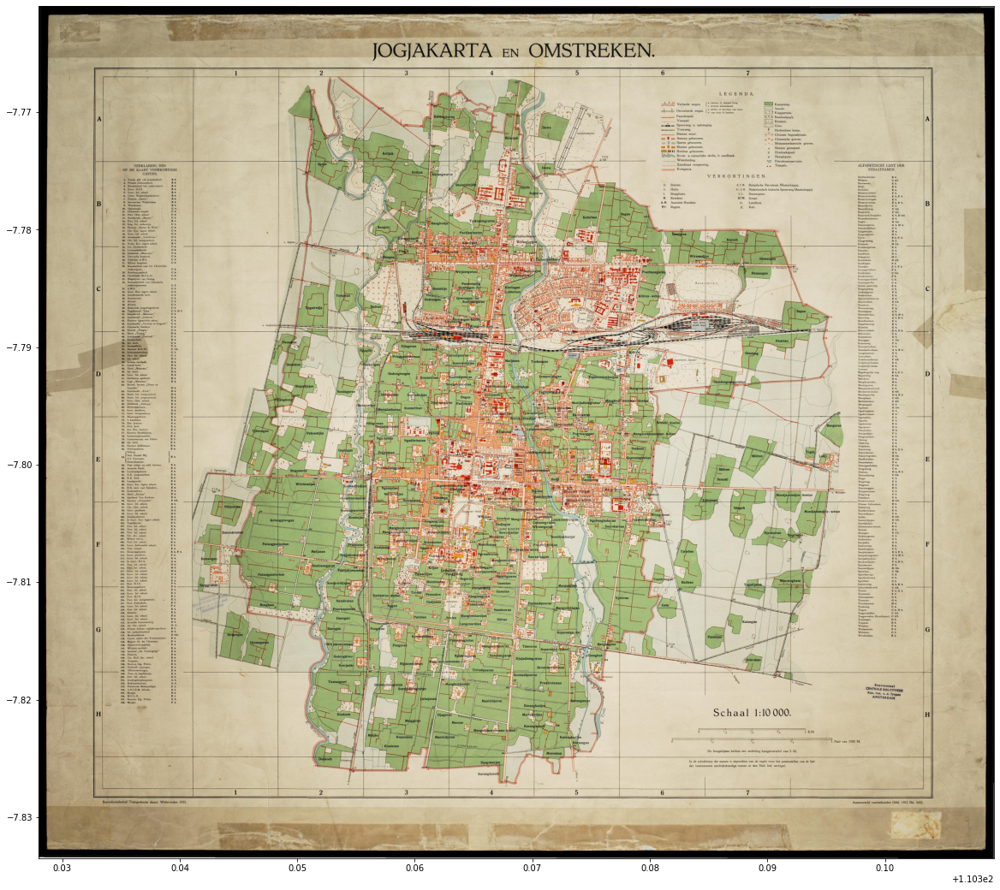

In [20]:
from matplotlib import pyplot as plt
from rasterio.plot import show

# enlarge the plot
plt.rcParams["figure.figsize"] = (20,20)


# calling the image as source
# python 'with' ensures that the file is closed after the iteration
with rasterio.open("jogja.tif") as src:
  # checking the loaded data
  print(src.crs)
  print(src.meta)
  show(src.read(), transform=src.transform)

And that's the map with all its glory. The map lists several important buildings in Yogyakarta during collonial era. We'll try to extract the footprint of this buildings using several methods mentioned above.

### Clip the map

Since the map also contains legends and additional texts which may affect our extraction attempt, we need to clip the map to exclude this accessories. First let's download the clipper GeoJSON polygon:

In [21]:
url = 'https://raw.githubusercontent.com/danylaksono/historical-map-extraction/main/Data/clipper.geojson'
shapes = gpd.read_file(url)
print(shapes.head())

                                            geometry
0  POLYGON ((110.35370 -7.76704, 110.35206 -7.767...


Next, we use Rasterio mask to clip the map

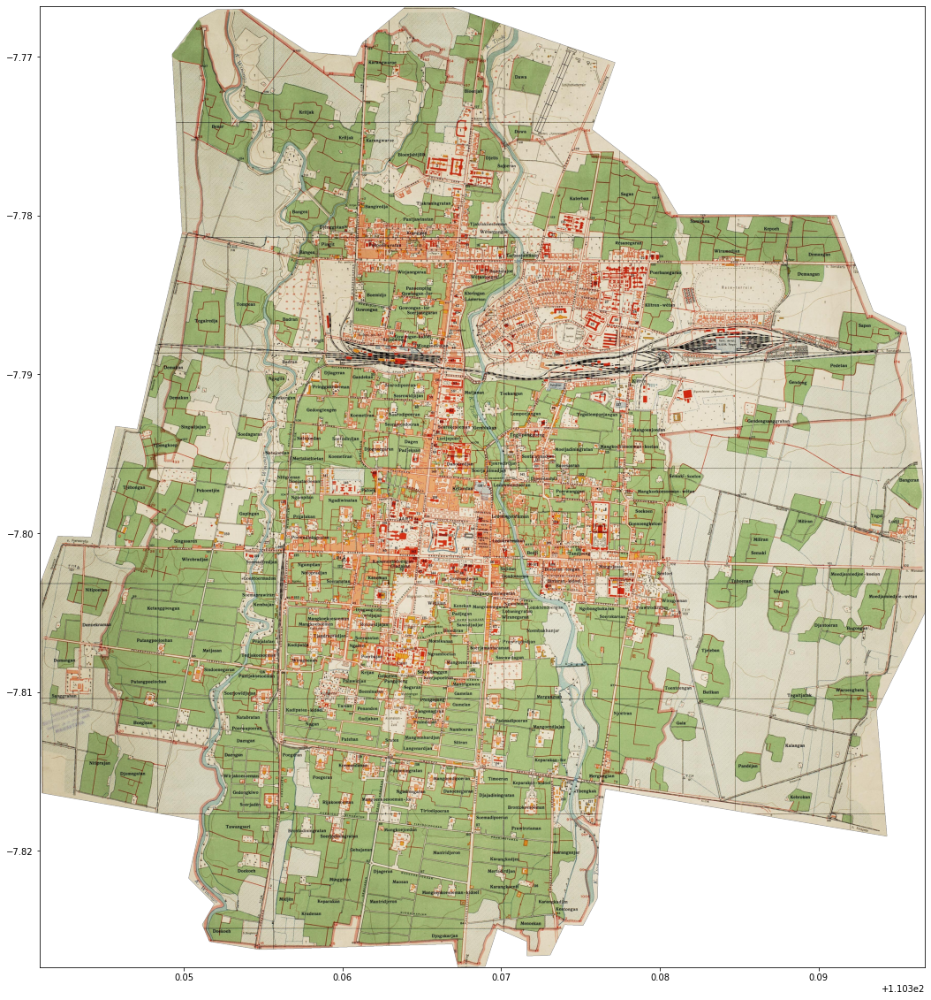

In [22]:
# clip the image
with rasterio.open("jogja.tif") as src:
    out_image, out_transform = rasterio.mask.mask(src, shapes.geometry, crop=True)
    out_meta = src.meta
    
# update metadata for writing
out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})

# write the clipped image
with rasterio.open("jogja_clipped.tif", "w", **out_meta) as dest:
    dest.write(out_image)

# show clipped map
clippedsrc = rasterio.open("jogja_clipped.tif")
show(clippedsrc.read(), transform=clippedsrc.transform)

What is the size of the map in pixels?

In [23]:
print(clippedsrc.height)
print(clippedsrc.width)


3724
3433


In [24]:
#clippedsrc.close()

## Object Extraction using Image Processing

Our first attempt to extract the buildings is to obtain the footprint based on its pixel values

### Get a subset of the map


Let's test our image extraction algoritm to a subset of the map. 


(3, 800, 1200)


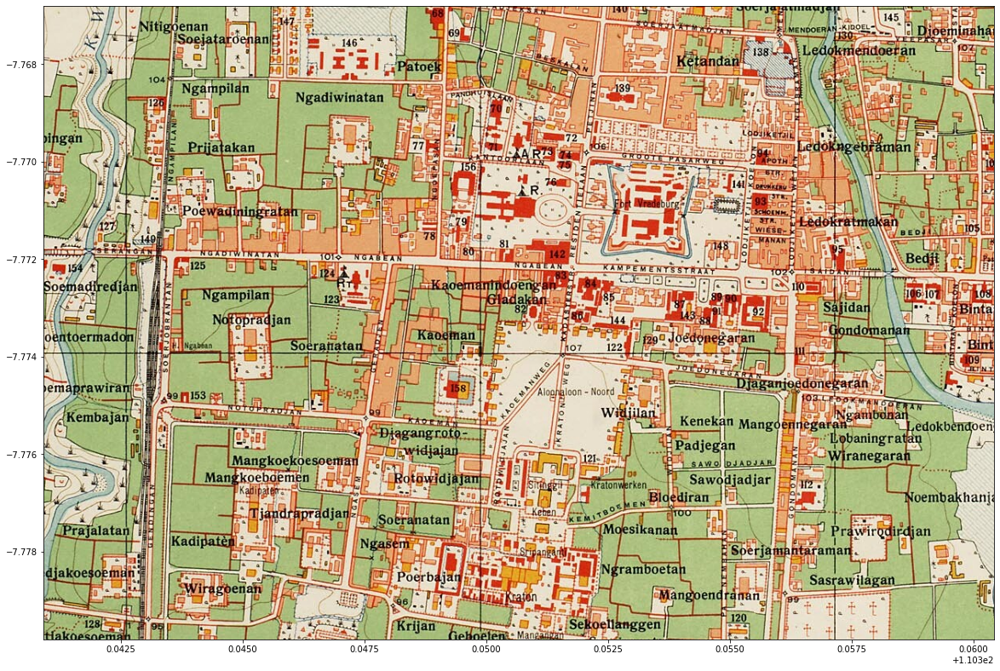

In [25]:
import matplotlib.pyplot as plt
from rasterio.plot import show

clipped_img = clippedsrc.read([1,2,3])[:, 1800:2600, 800:2000]

# update metadata for writing
out_meta.update({"driver": "JPEG",
                 "height": clipped_img.shape[1],
                 "width": clipped_img.shape[2],
                 'count': 3,
                 "transform": clippedsrc.transform})

with rasterio.open("jogja_subset.jpg", "w", **out_meta) as dest:
    dest.write(clipped_img)
    
print(clipped_img.shape)
fig, ax = plt.subplots(figsize=(20,17))
show(clipped_img[:, :, :], ax=ax, transform=clippedsrc.transform)

### Extract object by color

We're going to experiment with OpenCV's functions to extract useful information from an image

In [26]:
import cv2

#from google.colab.patches import cv2_imshow

img = cv2.imread('jogja_subset.jpg')


print(img.shape) #menampilkan resolusi
print(img.size) #menampilkan ukuran data pada media penyimpan
print(img.dtype) #image datatype (kedalaman bit) 


(800, 1200, 3)
2880000
uint8


We could employ simple color extraction by converting the image's colorspace to HSV. This will make selecting object easier compared to RGB colorspace. As a reference, here is the 'hue' band which contains all the colors:

![Hue Scale](https://upload.wikimedia.org/wikipedia/commons/thumb/a/ad/HueScale.svg/360px-HueScale.svg.png)

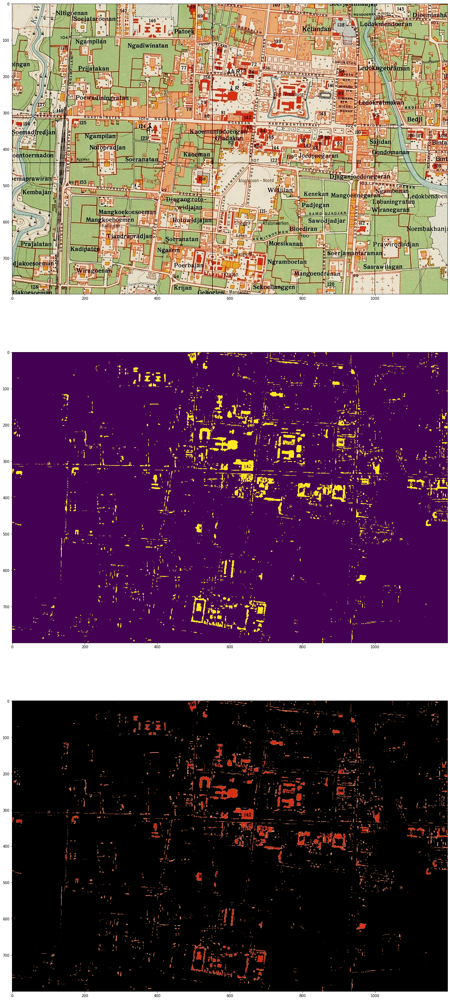

In [27]:
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV);

batas_bawah = 1 #lower threshold for buildings
batas_atas = 8 #Upper threshold for buildings

lower_sv = np.array([batas_bawah,100,100])
upper_sv = np.array([batas_atas,255,255])

# membuat masking untuk mencari objek sesuai batas warna
mask = cv2.inRange(hsv, lower_sv, upper_sv)

# Operasi Bitwise-AND 
res = cv2.bitwise_and(img, img, mask=mask)

fig, axs = plt.subplots(3,1,figsize=(50,50))

axs[0].imshow(img[:, :, [2, 1, 0]])
axs[1].imshow(mask)
axs[2].imshow(res[:, :, [2, 1, 0]])

From the steps above it's shown that we could extract the buildings based on its distictive color. We could improve the result by implementing some additional steps as follow

### Image Filtering

There are several techniques to further improve the result of object detection based on the previous result. A series of lowpass-filtering, morphological filtering and thresholding could be used to remove unwanted artifacts from the image.

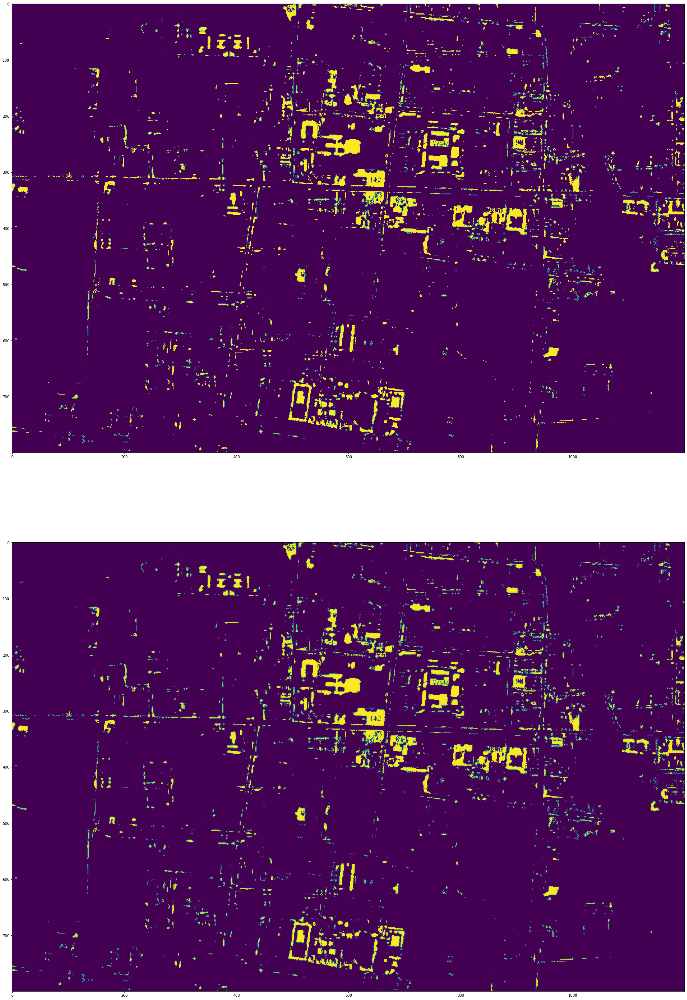

In [28]:
blur = cv2.bilateralFilter(mask,9,100,100)
fig, axs = plt.subplots(2,1,figsize=(50,50))
axs[0].imshow(mask)
axs[1].imshow(blur)


### Erosion and Dilation

Morphological operations are often used to remove unwanted artifacts on object extraction. Here we used 5x5 kernel to perform 'opening' and 'closing' to remove smaller objects on the image:

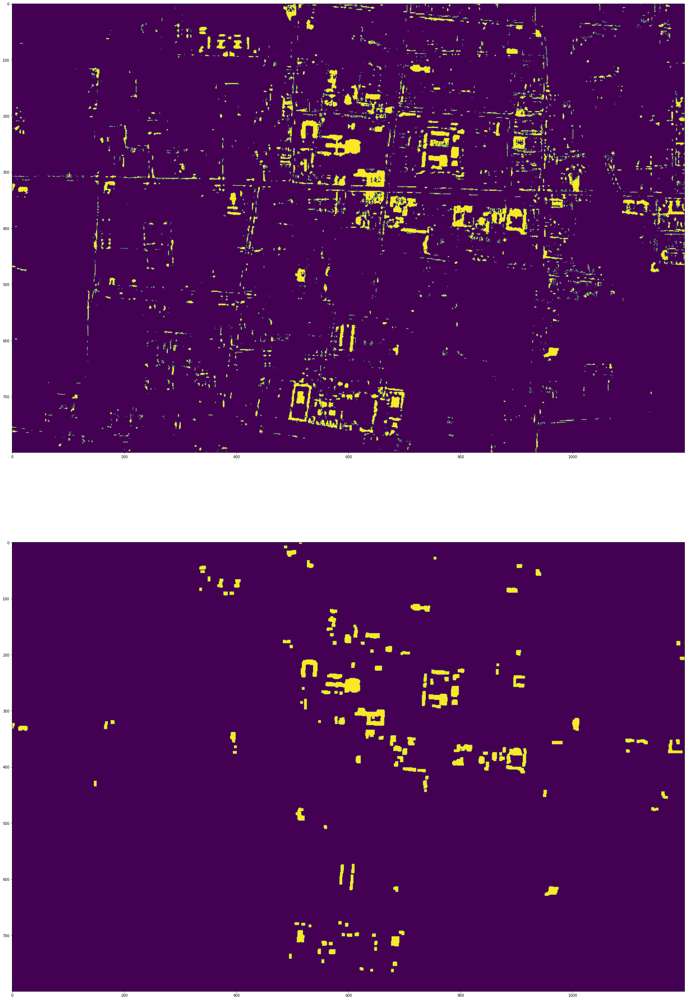

In [29]:
kernel = np.ones((5,5),np.uint8)

closing = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
opening = cv2.morphologyEx(closing, cv2.MORPH_OPEN, kernel)
erosion = cv2.erode(mask,kernel,iterations = 1)
dilation = cv2.dilate(erosion,kernel,iterations = 1)

fig, axs = plt.subplots(2,1,figsize=(50,50))
axs[0].imshow(mask)
axs[1].imshow(dilation)

### Draw Contours on the Building

Once we found the building footprint, we could utilize OpenCV to polygonize the extent using contours.

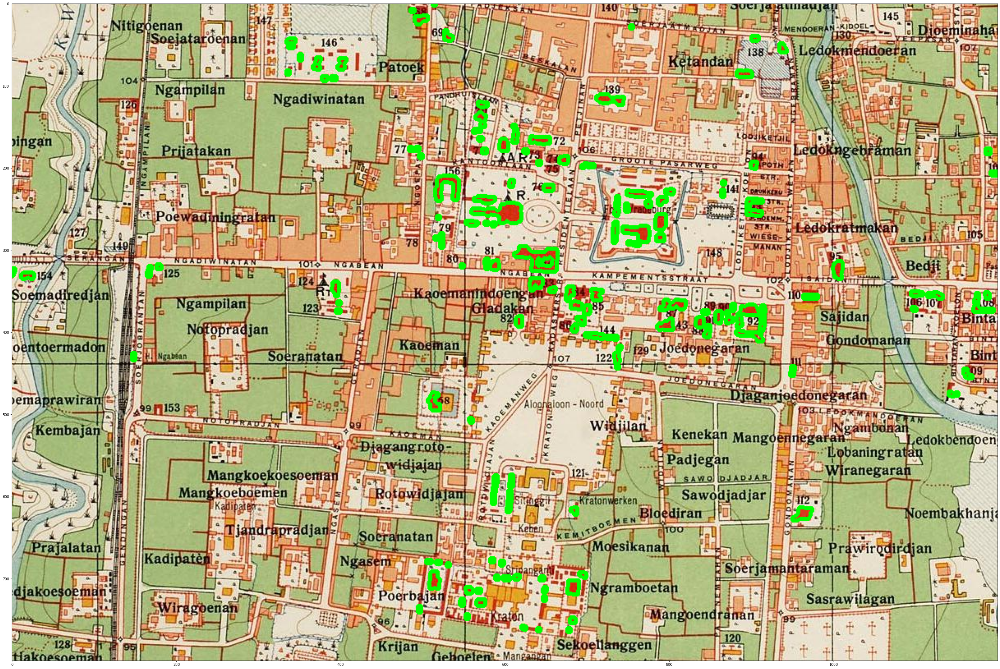

In [30]:
# thresholding might be needed for some distinct cases
#ret,th = cv2.threshold(dilation,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

contours, hierarchy = cv2.findContours(dilation,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
img = cv2.drawContours(img, contours, -1, (0,255,0), 3)
fig, axs = plt.subplots(1,1,figsize=(50,50))
axs.imshow(img[:, :, [2, 1, 0]])


### Convert resulting contours to polygon

The final step in this section is to convert the resulting OpenCV contour to Shapely Polygon. The code below does this job efficiently:

In [31]:
from collections import defaultdict
from shapely.geometry import MultiPolygon, Polygon

# thanks to https://michhar.github.io/masks_to_polygons_and_back/
def mask_to_polygons(mask, epsilon=10., min_area=10.):
    """Convert a mask ndarray (binarized image) to Multipolygons"""
    # first, find contours with cv2: it's much faster than shapely
    contours, hierarchy = cv2.findContours(mask,
                                  cv2.RETR_CCOMP,
                                  cv2.CHAIN_APPROX_NONE)
    if not contours:
        return MultiPolygon()
    # now messy stuff to associate parent and child contours
    cnt_children = defaultdict(list)
    child_contours = set()
    assert hierarchy.shape[0] == 1
    # http://docs.opencv.org/3.1.0/d9/d8b/tutorial_py_contours_hierarchy.html
    for idx, (_, _, _, parent_idx) in enumerate(hierarchy[0]):
        if parent_idx != -1:
            child_contours.add(idx)
            cnt_children[parent_idx].append(contours[idx])
    # create actual polygons filtering by area (removes artifacts)
    all_polygons = []
    for idx, cnt in enumerate(contours):
        if idx not in child_contours and cv2.contourArea(cnt) >= min_area:
            assert cnt.shape[1] == 1
            poly = Polygon(
                shell=cnt[:, 0, :],
                holes=[c[:, 0, :] for c in cnt_children.get(idx, [])
                       if cv2.contourArea(c) >= min_area])
            all_polygons.append(poly)
    all_polygons = MultiPolygon(all_polygons)

    return all_polygons

In [32]:
# here's the polygon
polys = mask_to_polygons(dilation, min_area=50)

The result is extracted Shapely multipolygon from OpenCV contours, which could be converted to geodataframe and used for further analysis.

## Image Classification with Machine Learning

In this section we employ machine learning methods (i.e. classification) to detect the buildings. We utilize Scikit-Learn library which have plenty of useful modules for machine learning. In this case we utilize Naive Bayes Classifier to obtain building footprint based on the training dataset that will be provided.

### Install and prepare dependencies

Several additional steps need to be performed before we could use the libraries below. We also need to address some issues with incompatibility between some of the library.

In [33]:
!add-apt-repository ppa:ubuntugis/ubuntugis-unstable -y
!apt-get update
!apt-get install python-numpy gdal-bin libgdal-dev python3-rtree

!pip install rasterio
!pip install geopandas
!pip install descartes
!pip install solaris
!pip install rio-tiler

Get:1 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:2 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Ign:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:4 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Hit:5 http://archive.ubuntu.com/ubuntu bionic InRelease
Ign:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Get:7 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release [697 B]
Hit:8 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:9 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release.gpg [836 B]
Get:10 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Hit:11 http://ppa.launchpad.net/cran/libgit2/ubuntu bionic InRelease
Get:12 http://archive.ubuntu.com/ubuntu bionic-backpor

### Preparing data

The training data have been prepared on this notebook's github repo. We will call the data and import it as a geopandas geodataframe:

In [34]:
training = gpd.read_file('https://raw.githubusercontent.com/danylaksono/historical-map-extraction/main/Data/training_labels.geojson')
training.head(-10)

,id,class,classess,geometry
0,None,1,bangunan,"MULTIPOLYGON (((110.36732 -7.77692, 110.36752 ..."
1,None,1,bangunan,"MULTIPOLYGON (((110.36568 -7.77647, 110.36647 ..."
2,None,1,bangunan,"MULTIPOLYGON (((110.36695 -7.77834, 110.36742 ..."
3,None,1,bangunan,"MULTIPOLYGON (((110.37497 -7.78053, 110.37509 ..."
4,None,1,bangunan,"MULTIPOLYGON (((110.37466 -7.78101, 110.37484 ..."
...,...,...,...,...
105,None,3,sawah,"MULTIPOLYGON (((110.34201 -7.80430, 110.34302 ..."
106,None,5,pemukiman,"MULTIPOLYGON (((110.35932 -7.80074, 110.35981 ..."
107,None,5,pemukiman,"MULTIPOLYGON (((110.36013 -7.80082, 110.36073 ..."
108,None,5,pemukiman,"MULTIPOLYGON (((110.36141 -7.80002, 110.36152 ..."


In [35]:
# reclassify
# this step is needed if we instead want to select the class prior to fitting
# training['class'] = training.classess.str.contains('bangunan').map({True:'1',False:'0'})

Let's see how the data looks like:

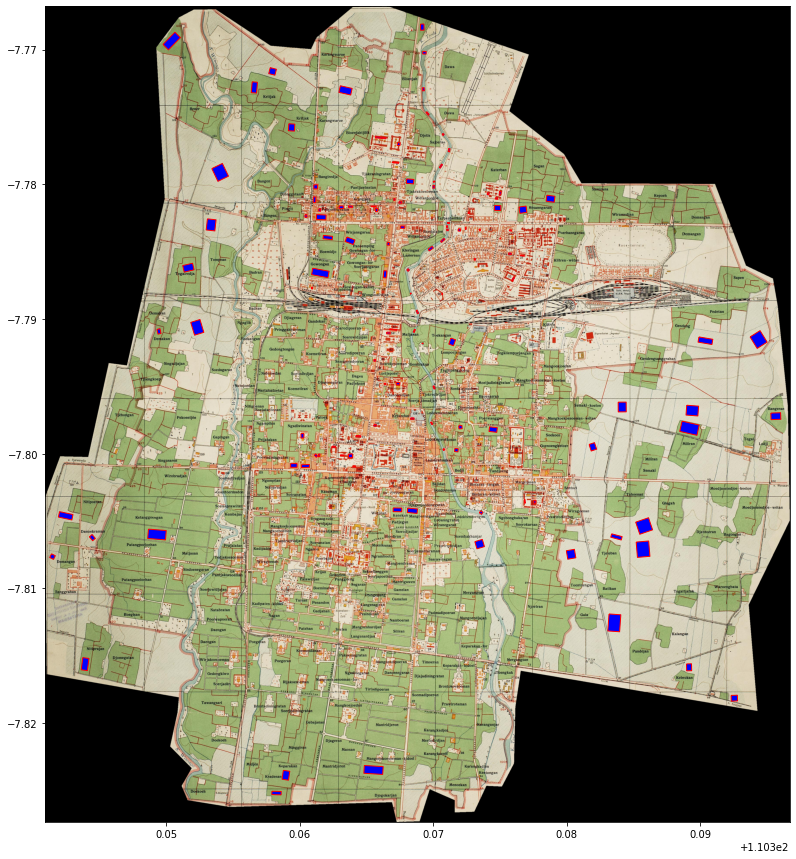

In [37]:
# plot training data and image
fig, ax = plt.subplots(figsize=(15, 15))
rasterio.plot.show(clippedsrc, ax=ax)
training.plot(ax=ax, facecolor='blue', edgecolor='r');

In [38]:
# How many data?
training.groupby(['class']).agg(["count"])

,id,classess,geometry
,count,count,count
class,,,
1,0,26,26
2,0,26,26
3,0,21,21
4,0,22,22
5,0,25,25


In the above code we saw that there are 5 classes, each contain at least 20 training area as input for Naive Bayes Classifier. Next, we arrange the data as numpy flattened array for classification purpose:

In [39]:
# train the model to the whole data

X = np.array([], dtype=np.int8).reshape(0,4) # pixels for training
y = np.array([], dtype=np.string_) # labels for training

Next, we need to extract pixel values from each of the geometry above:

In [40]:
# extract pixel value

geoms = training.geometry.values 
# extract the raster values within the polygon 
with rasterio.open("jogja_clipped.tif") as src:
    band_count = src.count
    for index, geom in enumerate(geoms):
        feature = [mapping(geom)]

        # the mask function returns an array of the raster pixels within this feature
        out_image, out_transform = rasterio.mask.mask(src, feature, crop=True) 
        # eliminate all the pixels with 0 values for all 8 bands - AKA not actually part of the shapefile
        out_image_trimmed = out_image[:,~np.all(out_image == 0, axis=0)]
        # eliminate all the pixels with 255 values for all 8 bands - AKA not actually part of the shapefile
        out_image_trimmed = out_image_trimmed[:,~np.all(out_image_trimmed == 255, axis=0)]
        # reshape the array to [pixel count, bands]
        out_image_reshaped = out_image_trimmed.reshape(-1, band_count)
        # append the labels to the y array
        y = np.append(y,[training["class"][index]] * out_image_reshaped.shape[0]) 
        # stack the pizels onto the pixel array
        X = np.vstack((X,out_image_reshaped))        


We intend to obtain only building (class=1), but since the training data contains other classess as well, we need to simplify the classification with the risk of having a model with imbalanced class:


In [41]:
# What are our classification labels?
labels = np.unique(training["class"])
print('The training data include {n} classes: {classes}\n'.format(n=labels.size, 
                                                                classes=labels))

# We will need a "X" matrix containing our features, and a "y" array containing our labels
print('Our X matrix is sized: {sz}'.format(sz=X.shape))
print('Our y array is sized: {sz}'.format(sz=y.shape))

The training data include 5 classes: ['1' '2' '3' '4' '5']

Our X matrix is sized: (82110, 4)
Our y array is sized: (82110,)


In [42]:
print(y)

['1' '1' '1' ... '5' '5' '5']


### Divide and Conquer

To avoid high memory consumption, we will divide the data to tiles, which will be processed one at a time or in parallel according to the available computational power. 

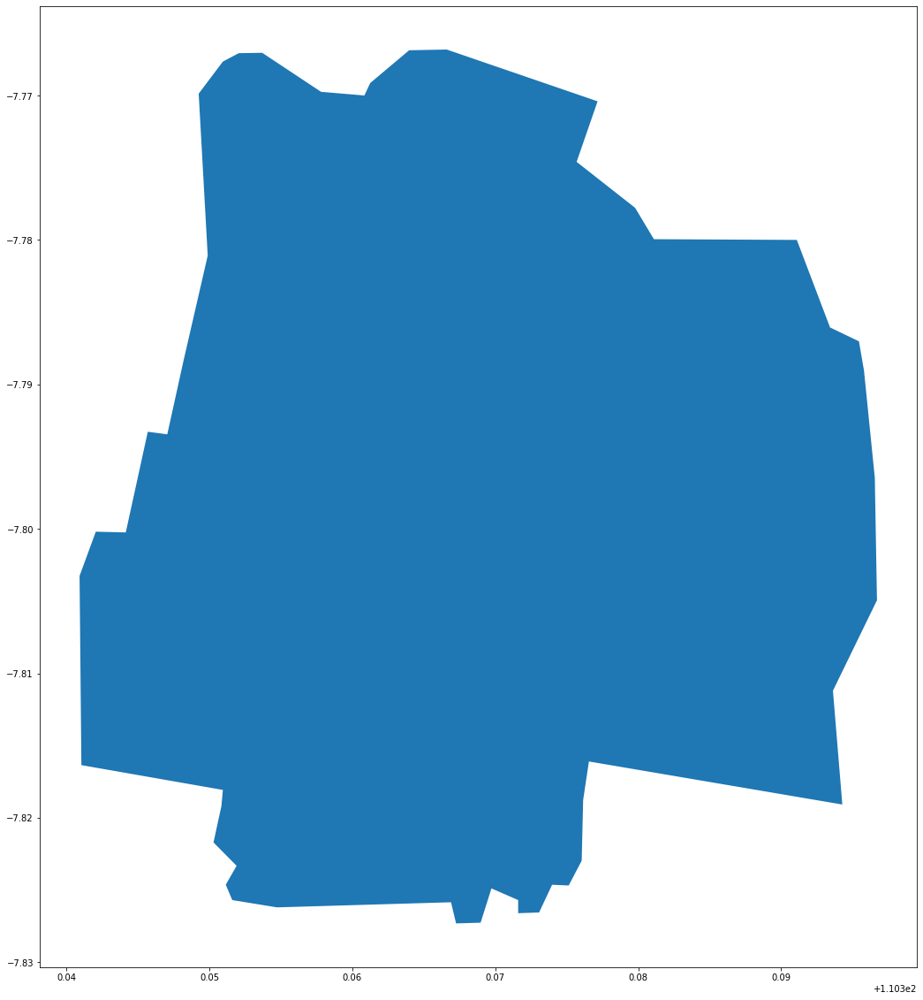

In [43]:
# the clipping polygon
aoi_df = gpd.read_file(url)
aoi_df.plot()

In [44]:
# Convert this to geojson
aoi_df.to_file('aoi.geojson', driver='GeoJSON')

[Supermercado](https://github.com/mapbox/supermercado) is a tool to draw tiles according to slippy map tiles specification. We could use the tool to draw fishnet around the area

In [45]:
# the tiling engine
!pip install supermercado

In [46]:
# tiling parameters. See Slippy maps specification for more detail
tile_size = 256 #in pixels
zoom_level = 15 #according to slippy maps specs

next, we draw the polygon by 'burning' the clip area:

In [47]:
#Some men just want to watch the tile burn
!cat aoi.geojson | supermercado burn {zoom_level} | mercantile shapes | fio collect > aoi_z{zoom_level}tiles.geojson

/usr/local/lib/python3.7/dist-packages/cligj/__init__.py:113: FutureWarning: Sequences of Features, not FeatureCollections, will be the default in version 1.0.0
  FutureWarning,


In [48]:
# read the generated tiles
aoi_tiles = gpd.read_file(f'aoi_z{zoom_level}tiles.geojson')

And here's our tiles:

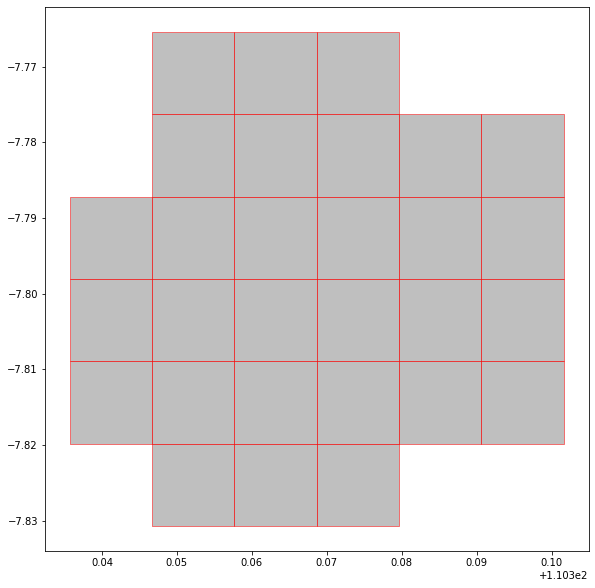

In [49]:
#And plot it
fig, ax = plt.subplots(figsize=(10,10))
aoi_tiles.plot(ax=ax, color='grey', alpha=0.5, edgecolor='red')

In [50]:
# what does the data looked like?
aoi_tiles.head()

,id,title,geometry
0,"(26428, 17093, 15)","XYZ tile (26428, 17093, 15)","POLYGON ((110.34668 -7.77631, 110.34668 -7.765..."
1,"(26429, 17093, 15)","XYZ tile (26429, 17093, 15)","POLYGON ((110.35767 -7.77631, 110.35767 -7.765..."
2,"(26430, 17093, 15)","XYZ tile (26430, 17093, 15)","POLYGON ((110.36865 -7.77631, 110.36865 -7.765..."
3,"(26428, 17094, 15)","XYZ tile (26428, 17094, 15)","POLYGON ((110.34668 -7.78719, 110.34668 -7.776..."
4,"(26429, 17094, 15)","XYZ tile (26429, 17094, 15)","POLYGON ((110.35767 -7.78719, 110.35767 -7.776..."


In [51]:
# for easier indexing
def reformat_xyz(tile_gdf):
  tile_gdf['xyz'] = tile_gdf.id.apply(lambda x: x.lstrip('(,)').rstrip('(,)').split(','))
  tile_gdf['xyz'] = [[int(q) for q in p] for p in tile_gdf['xyz']]
  return tile_gdf

In [52]:
# newly added xyz column
aoi_tiles = reformat_xyz(aoi_tiles)
aoi_tiles.head()

,id,title,geometry,xyz
0,"(26428, 17093, 15)","XYZ tile (26428, 17093, 15)","POLYGON ((110.34668 -7.77631, 110.34668 -7.765...","[26428, 17093, 15]"
1,"(26429, 17093, 15)","XYZ tile (26429, 17093, 15)","POLYGON ((110.35767 -7.77631, 110.35767 -7.765...","[26429, 17093, 15]"
2,"(26430, 17093, 15)","XYZ tile (26430, 17093, 15)","POLYGON ((110.36865 -7.77631, 110.36865 -7.765...","[26430, 17093, 15]"
3,"(26428, 17094, 15)","XYZ tile (26428, 17094, 15)","POLYGON ((110.34668 -7.78719, 110.34668 -7.776...","[26428, 17094, 15]"
4,"(26429, 17094, 15)","XYZ tile (26429, 17094, 15)","POLYGON ((110.35767 -7.78719, 110.35767 -7.776...","[26429, 17094, 15]"


In [53]:
len(aoi_tiles)

29

In [54]:
# Now we can summon the tile based on its index and 
# get the xyz format
idx = 5 #fifth tile in series
aoi_tiles.iloc[idx]['xyz']

[26430, 17094, 15]

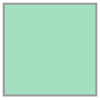

In [55]:
aoi_tiles.iloc[idx]['geometry']

Now that we have each tile, we need to cut the image based on each tile's index. The steps below is needed since there seems to be a bug on how Shapely and Rasterio behave in Google Colab.

In [56]:
import pyproj
projlib = pyproj.datadir.get_data_dir()

# redefine the PROJ_LIB env, which are overrided by Fiona
%env PROJ_LIB=$projlib
!echo $PROJ_LIB

And in the cell below, we conduct the clipping:

In [60]:
from shapely.geometry import mapping

# define the tiled data directory
data_dir = "tiled_aoi"
if not os.path.exists(data_dir):
    os.makedirs(data_dir)

# saving geometry values
geoms = aoi_tiles.geometry.values 

# extract the raster values within the polygon 
with rasterio.open("jogja_clipped.tif") as src:
    for index, geom in enumerate(geoms):
        fp = os.path.join(data_dir, str(index+1) +".tif")
        feature = [mapping(geom)]

        out_image, out_transform = rasterio.mask.mask(src, feature, crop=True)
        out_meta = src.meta
    
        # update metadata for writing
        out_meta.update({"driver": "GTiff",
                    "height": out_image.shape[1],
                    "width": out_image.shape[2],
                    "transform": out_transform})
        
        # write the clipped image
        with rasterio.open(fp, "w", **out_meta) as dest:
                      dest.write(out_image) 


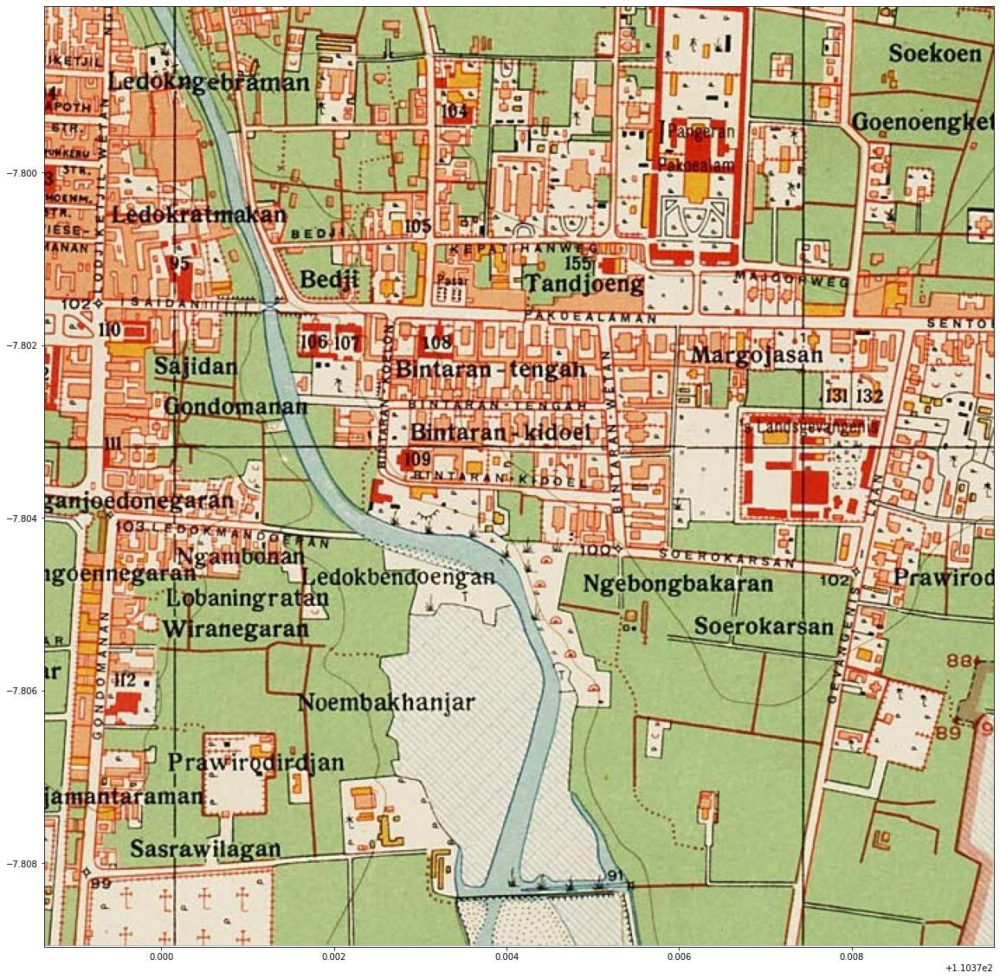

In [62]:
#Display one of the tiles
import rasterio

plt.rcParams["figure.figsize"] = (20,20)

tile3 = rasterio.open("./tiled_aoi/18.tif")
show(tile3.read(), transform=tile3.transform)

If you look at the Google Colab files on your left, you'll find the files we created from the code above, which is images clipped from the tiles we just made.

### Train the model

Next we will perform the training. We use Naive Bayes Classifier for this purpose, though comparing several different classifier algorithm is encouraged.


In [63]:
from rasterio.plot import show
from rasterio.plot import show_hist
from rasterio.windows import Window
from rasterio.plot import reshape_as_raster, reshape_as_image

In [64]:
#from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import GaussianNB

gnb = GaussianNB()
gnb.fit(X, y) # fitting our X to y, or features to label

GaussianNB(priors=None, var_smoothing=1e-09)

Let's take one of the file and process further:

In [65]:
with rasterio.open("./tiled_aoi/18.tif") as src:
    # may need to reduce this image size if your kernel crashes, takes a lot of memory
    img = src.read() #[:, 150:600, 250:1400]

    # Take our full image and reshape into long 2d array (nrow * ncol, nband) for classification
    print(img.shape)
    reshaped_img = reshape_as_image(img)
    print(reshaped_img.shape)

(4, 671, 677)
(671, 677, 4)


In [66]:
class_prediction = gnb.predict(reshaped_img.reshape(-1, 4))
#class_prediction = gnb.predict(reshaped_img)
print(class_prediction)

# Reshape our classification map back into a 2D matrix so we can visualize it
class_prediction = class_prediction.reshape(reshaped_img[:, :, 0].shape)

['1' '1' '1' ... '1' '1' '1']


In [67]:
def str_class_to_int(class_array):
    class_array[class_array == '1'] = 1
    class_array[class_array == '2'] = 2
    class_array[class_array == '3'] = 3
    class_array[class_array == '4'] = 4
    class_array[class_array == '5'] = 5
    return(class_array.astype(float))

class_prediction = str_class_to_int(class_prediction)

The steps above give the predicted class for each pixel in the input image, which is one of the tiles generated by Supermercado. Let's view the classification result:

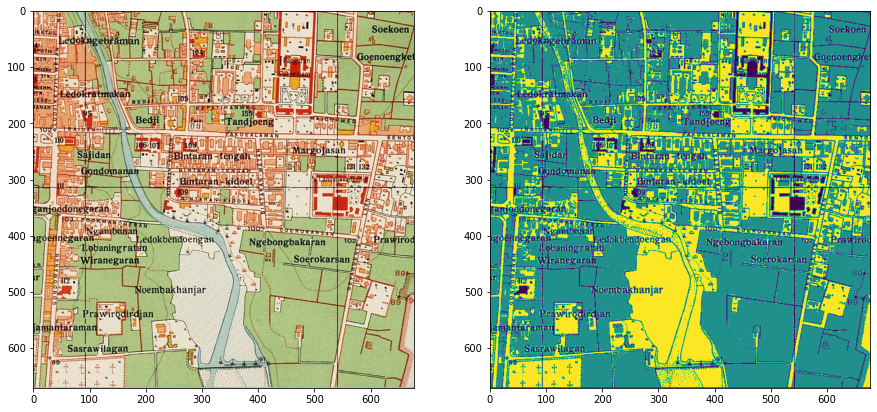

In [68]:
%matplotlib inline
import matplotlib.pyplot as plt

# Now show the classmap next to the image
fig, axs = plt.subplots(1,2,figsize=(15,8))

axs[0].imshow(reshaped_img, label="Original Tile")
axs[1].imshow(class_prediction, label="Detected Class")

We could see that our buildings are marked with distinctive color compared to other objects in the map. Next, we could employ similar steps to the image to extract only buildings, just like the earlier steps

### Convert to Polygon

In [70]:
#from shapely.geometry import Polygon
#polygon = Polygon(class_prediction)
#print(polygon.wkt)

## Unsupervised Classification

Supervised classification usually yields better results for classification, due to the available training data which provides more information for machine learning model. However we could also try unsupervised classification so that we could compare the result. In this case, we employ K-Nearest Neighbor which is widely used for similar cases.

In [73]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import colors
from skimage.color import rgb2gray, rgb2hsv, hsv2rgb
from skimage.io import imread, imshow
from sklearn.cluster import KMeans

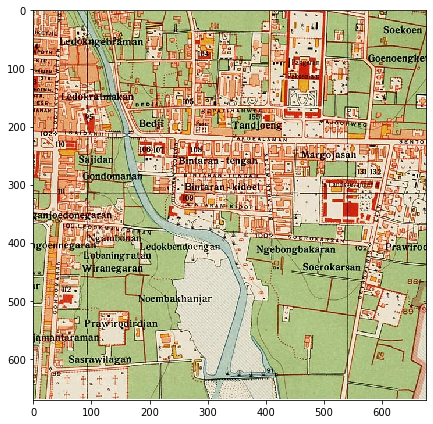

In [74]:
tile = imread('./tiled_aoi/18.tif')
plt.figure(num=None, figsize=(8, 6))
imshow(tile);

In [75]:
def image_to_pandas(image):
    df = pd.DataFrame([image[:,:,0].flatten(),
                       image[:,:,1].flatten(),
                       image[:,:,2].flatten()]).T
    df.columns = ['red','green','blue']
    return df
df_tile = image_to_pandas(tile)
df_tile.head(5)

,red,green,blue
0,0,0,0
1,0,0,0
2,0,0,0
3,0,0,0
4,0,0,0


/usr/local/lib/python3.7/dist-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


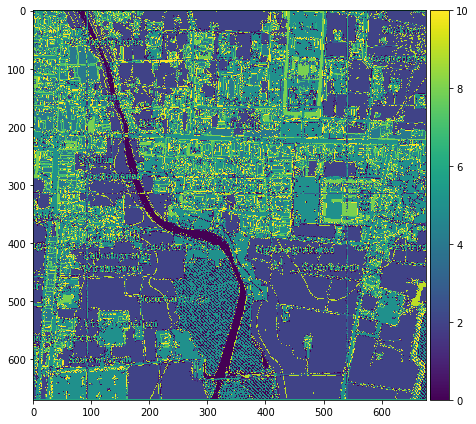

In [76]:
plt.figure(num=None, figsize=(8, 6))
kmeans = KMeans(n_clusters=  11, random_state = 50).fit(df_tile)
result = kmeans.labels_.reshape(tile.shape[0],tile.shape[1])
imshow(result, cmap='viridis')
plt.show()

In [77]:
type(result)

numpy.ndarray

In [78]:
mask.dtype

dtype('uint8')

In [79]:
# reclass
building_class = result.copy()
#building_class[(building_class == 8)] = 1
building_class[(building_class < 8)] = 0
building_class[(building_class > 8)] = 0
building_class.astype('uint8') 


array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 8, 0],
       [0, 0, 0, ..., 8, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

/usr/local/lib/python3.7/dist-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


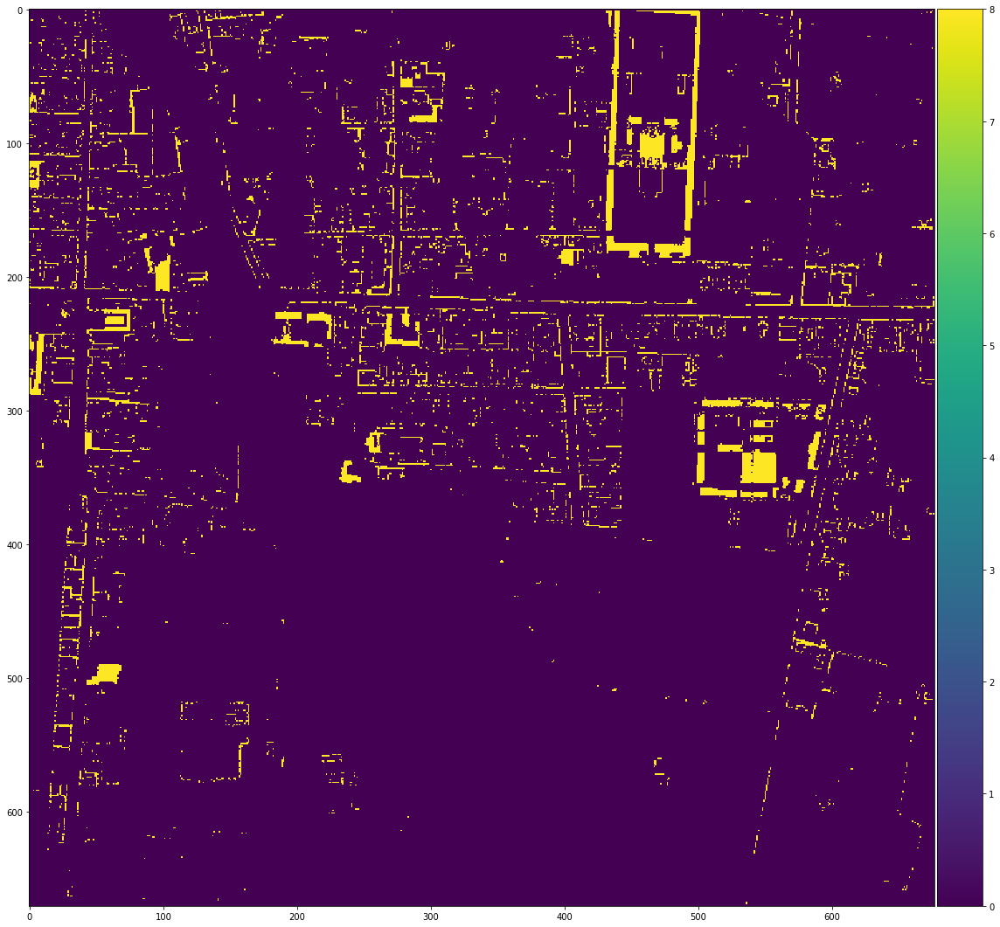

In [80]:
plt.rcParams["figure.figsize"] = (16,16)

imshow(building_class, cmap='viridis')
plt.show()

And that's the result of our unsupervised classification. Again we could refine the result using additional steps for image processing. As well as develop a function to loop through each tiles which we generate earlier.

## Future Scenarios

Several discussion (such as [this one](https://www.springerprofessional.de/en/training-deep-learning-models-for-geographic-feature-recognition/17398634)) has successfully extract meaningful information from historical maps using Deep Learning Methods. Therefore, future scenarios on implementing deep learning for semantic segmentation of historical maps are:

* Utilize pre-trained model which are trained on similar dataset, such as Resnet or VGG. Several result from satellite imagery segmentation shows promising result using VGG16, and thus it is possible to utilize similar scenario on the case of semantic segmentation on historical maps
* Experiment with transfer learning freezing layer, and develop multiple dense layers capable of abstracting several features of the map, since historical maps contains a lot of artifacts which are apparent in the above case 
* Testing multiple datasets. Different historical maps tends to have different case due to paper or scan condition

Deep learning is trully promising for semantic segmentation, and code sample for the case will hopefully be provided here in near future.




## References

* https://medium.com/@anthropoco/how-to-segment-buildings-on-drone-imagery-with-fast-ai-cloud-native-geodata-tools-ae249612c321
* https://github.com/robmarkcole/satellite-image-deep-learning#interesting-deep-learning-projects
* https://github.com/acgeospatial/Satellite_Imagery_Python/blob/master/Clustering_KMeans-Sentinel2.ipynb
* https://mygeoblog.com/2020/09/22/rice-mapping-using-deep-neural-networks/
* https://www.springerprofessional.de/en/training-deep-learning-models-for-geographic-feature-recognition/17398634
